<div style="text-align: center;">
    <img src="https://i.pinimg.com/originals/b3/2a/f4/b32af410be8257b815d16d9ef0f01aa7.gif" alt="Airbnb Logo" style="width: 40%; height: 30%;" />
    <!-- <img src="Images/airbnb.gif" alt="Airbnb Logo" style="width: 40%; height: 30%;" /> -->
    <img src="https://static.designboom.com/wp-content/uploads/2014/07/airbnb_500.gif" alt="Airbnb Logo" style="width: 37.5%; height: auto;" />
</div>

# Background
<b>Airbnb</b>: Airbnb is an online marketplace for arranging or renting lodging, primarily homes or apartments. It is a platform that connects people who want to rent out their spare rooms or properties for a short or long term period, with people who are looking for accommodation. The platform offers a wide range of services, including property search, booking, and communication.

<b>Problem Statement</b>:

<b>Objective</b>

# Data Description

This dataset contains information about the customers of a company. The dataset contains the following features: 

* `id`: Airbnb's unique identifier for the listing.
* `name`: Name of the listing.
* `host_id`: Airbnb's unique identifier for the host/user.
* `host_name`: Name of the host. Usually, just the first name(s).
* `neighborhood`: The neighborhood is geocoded using the latitude and longitude against neighborhoods as defined by open or public digital shapefiles.
* `latitude`: Uses the World Geodetic System (WGS84) projection for latitude and longitude.
* `longitude`: Uses the World Geodetic System (WGS84) projection for latitude and longitude.
* `room_type`: [Entire home/apt | Private room | Shared room | Hotel]
* `price`: Daily price in local currency. Note, the $ sign may be used despite the locale.
* `minimum_nights`: The minimum number of night stays for the listing (calendarrules may differ).
* `number_of_reviews`: The number of reviews the listing has.
* `last_review`: The date of the last/newest review.
* `calculated_host_listings_count`: The number of listings the host has in the current scrape in the city/region geography.
* `availability_365`: avaliability_x. The calendar determines the availability of the listing x days in the future. Note a listing may be available because it has been booked by a guest or blocked by the host.
* `number_of_reviews_ltm`: The number of reviews the listing has (in the last 12 months).

# Library

In [1]:
# Essential libraries for data manipulation, geospatial, and numerical operations
import pandas as pd
import numpy as np
import geopandas as gpd
import fiona
from shapely.geometry import Point, LineString, MultiLineString, Polygon, GeometryCollection, mapping 
from scipy.stats import f_oneway, spearmanr, mannwhitneyu, ttest_ind, normaltest, chi2_contingency
from geojson_length import calculate_distance, Unit
from collections import Counter
import datetime as dt
import re
import string

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import folium
from folium.plugins import MarkerCluster, MousePosition, FloatImage, TagFilterButton, HeatMap
from branca.element import Figure
from wordcloud import WordCloud
%matplotlib inline

# Text processing
import nltk
from nltk.corpus import stopwords

# Language models (LLM)
from langchain_ollama.llms import OllamaLLM

# Suppress warnings
import warnings
warnings.filterwarnings("ignore")

import requests
from PIL import Image
from io import BytesIO
import base64

# Importing Data

In [2]:
df = pd.read_csv('Data/Airbnb Listings Bangkok.csv', index_col=0)
df.head(5)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


# Data Understanding

## Data Formatting

In [3]:
df['id'] = df['id'].astype('str')
df['host_id'] = df['host_id'].astype('str')
df['last_review'] = pd.to_datetime(df['last_review'])

def convert_to_category(col):
    if col.dtype == 'object':
        if col.nunique() / df.shape[0] < 0.05:
            return col.astype('category')
        else:
            return col
    else:
        return col

df = df.apply(lambda col: convert_to_category(col))
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15854 entries, 0 to 15853
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              15854 non-null  object        
 1   name                            15846 non-null  object        
 2   host_id                         15854 non-null  object        
 3   host_name                       15853 non-null  object        
 4   neighbourhood                   15854 non-null  category      
 5   latitude                        15854 non-null  float64       
 6   longitude                       15854 non-null  float64       
 7   room_type                       15854 non-null  category      
 8   price                           15854 non-null  int64         
 9   minimum_nights                  15854 non-null  int64         
 10  number_of_reviews               15854 non-null  int64         
 11  last_re

## Desctiptive Statistics

In [4]:
desc = df.describe().round(2).T
desc['Range'] = desc['max'] - desc['min']
desc['Variansi'] = df.var(numeric_only=True).round(2) 
desc

,count,mean,min,25%,50%,75%,max,std,Range,Variansi
latitude,15854.0,13.75,13.53,13.72,13.74,13.76,13.95,0.04,0.42,0.000000e+00
longitude,15854.0,100.56,100.33,100.53,100.56,100.59,100.92,0.05,0.59,0.000000e+00
price,15854.0,3217.7,0.0,900.0,1429.0,2429.0,1100000.0,24972.12,1100000.0,6.236069e+08
minimum_nights,15854.0,15.29,1.0,1.0,1.0,7.0,1125.0,50.82,1124.0,2.582170e+03
number_of_reviews,15854.0,16.65,0.0,0.0,2.0,13.0,1224.0,40.61,1224.0,1.649440e+03
last_review,10064,2021-08-30 08:37:49.316375296,2012-12-15 00:00:00,2020-02-20 00:00:00,2022-10-24 00:00:00,2022-12-08 00:00:00,2022-12-28 00:00:00,NaN,3665 days 00:00:00,NaN
reviews_per_month,10064.0,0.81,0.01,0.12,0.44,1.06,19.13,1.09,19.12,1.190000e+00
calculated_host_listings_count,15854.0,13.89,1.0,1.0,4.0,13.0,228.0,30.27,227.0,9.162600e+02
availability_365,15854.0,244.38,0.0,138.0,309.0,360.0,365.0,125.84,365.0,1.583652e+04
number_of_reviews_ltm,15854.0,3.48,0.0,0.0,0.0,3.0,325.0,8.92,325.0,7.951000e+01


In [5]:
df.describe(include='object').T

,count,unique,top,freq
id,15854,15854,27934,1
name,15846,14794,New! La Chada Night Market studio 2PPL near MRT,45
host_id,15854,6659,201677068,228
host_name,15853,5312,Curry,228


## Dataset summary

In [6]:
tabelDesc = pd.DataFrame(columns=['Column Name', 'Datatype', 'Missing Values (%)', 'Number of Unique', 'Percentage of Unique', 'Unique Value', ],
                            data=[[col, df[col].dtype, f"{(df[col].isna().mean() * 100).round(2)}%", df[col].nunique(), f'{round(df[col].nunique()/df.shape[0]*100,2)}%', df[col].unique()] for col in df.columns])
tabelDesc

,Column Name,Datatype,Missing Values (%),Number of Unique,Percentage of Unique,Unique Value
0,id,object,0.0%,15854,100.0%,"[27934, 27979, 28745, 35780, 941865, 1704776, ..."
1,name,object,0.05%,14794,93.31%,"[Nice room with superb city view, Easy going l..."
2,host_id,object,0.0%,6659,42.0%,"[120437, 120541, 123784, 153730, 610315, 21296..."
3,host_name,object,0.01%,5312,33.51%,"[Nuttee, Emy, Familyroom, Sirilak, Kasem, Wimo..."
4,neighbourhood,category,0.0%,50,0.32%,"['Ratchathewi', 'Bang Na', 'Bang Kapi', 'Din D..."
5,latitude,float64,0.0%,9606,60.59%,"[13.75983, 13.66818, 13.75232, 13.78823, 13.76..."
6,longitude,float64,0.0%,10224,64.49%,"[100.54134, 100.61674, 100.62402, 100.57256, 1..."
7,room_type,category,0.0%,4,0.03%,"['Entire home/apt', 'Private room', 'Hotel roo..."
8,price,int64,0.0%,3040,19.17%,"[1905, 1316, 800, 1286, 1000, 1558, 1461, 700,..."
9,minimum_nights,int64,0.0%,86,0.54%,"[3, 1, 60, 7, 250, 2, 15, 30, 28, 21, 27, 4, 1..."


## Duplicate Check

In [8]:
Number_of_columns = df.shape[1]
Number_of_rows = df.shape[0]
duplicate_rows = df[df.duplicated()].shape[0]
text_type = df.select_dtypes(include=['object']).shape[1] 
Numeric_type = df.select_dtypes(include=['int', 'float']).shape[1]
Categorical_type = df.select_dtypes(include=['category']).shape[1]
Datetime_type = df.select_dtypes(include=['datetime64']).shape[1]

dataset_sum = pd.DataFrame({'Number of columns': [Number_of_columns], 'Number of rows': [Number_of_rows], 'Duplicate rows': [duplicate_rows], 'Text type': [text_type], 'Numeric type': [Numeric_type], 'Categorical type': [Categorical_type], 'Datetime type': [Datetime_type]}).T.rename(columns={0: 'Value'})
dataset_sum

,Value
Number of columns,16
Number of rows,15854
Duplicate rows,0
Text type,4
Numeric type,9
Categorical type,2
Datetime type,1


## Missing Value

In [9]:
missing_count = df.isnull().sum().reset_index()
missing_count.columns = ['Column', 'Missing Count']
missing_count = missing_count.sort_values(by='Missing Count', ascending=True)


fig = px.bar(missing_count, 
             x='Missing Count', 
             y='Column', 
             title='Count of Missing Values per Column',
             labels={'Missing Count':'Number of Missing Values'},
             text_auto=True)

fig.show()

# Data Preprocessing

## Name

### Missing Value handling

In [10]:
print(f'before: {df.name.isna().sum()}')
df['name'] = df['name'].fillna('no name')
print(f'after: {df.name.isna().sum()}')

before: 8
after: 0


### clean text

In [11]:
(df.select_dtypes(include='object').sample(15, random_state=42).style.applymap(lambda x: 'color: red' if isinstance(x, str) and re.search(r'[^\u0000-\u007F]+', x) else ''))

,id,name,host_id,host_name
9489,39762269,"Executive Deluxe Room, I Residence Hotel Sathorn",301148796,Sawassakorn
14351,730403485467994514,"Easy going, 2 mins from BTS Ratchathewi, Block740",40563982,Nattarat
6264,30086067,One Bedroom Asoke area close to MRT/ARL /Nice unit,154634369,Mycondo
1662,11425056,1BR condo in Center of Bangkok!,60017041,Panuwat
5674,28089290,อพาร์ตเมนต์ 1 ห้องนอนที่ทันสมัย,212187760,Charlotte
7881,34920489,近onnut BTS站/高速WIFI/7-11便利店/15分钟到暹罗广场四面佛&泳池健身房&每客消毒,145673155,Cora
903,6949824,"studio, 900 m to BTS Phrom Phong BTS",23888912,Nalinee
13484,665087191522315628,THE SPRING BLOSSOM SUITE:1BR/WIFI/ASOKE/SHOPPING,133082557,Jean
6621,30974375,PLATINUM MALL | FAMILY ROOM | upto 4 ppl,192217276,Pratunam Design
12264,53873868,Escape Condo,436384240,บวร


In [12]:
df['name_ext'] = df['name']
df = df[['id', 'name', 'name_ext', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm']]

In [13]:
def clean_text(text):
    text = str(text).lower()  # Lowercase the text
    text = re.sub(r'\[.*?\]', ' ', text)  # Remove text in square brackets
    text = re.sub(r'https?://\S+|www\.\S+', ' ', text)  # Remove links
    text = re.sub(r'<.*?>+', ' ', text)  # Remove HTML tags
    text = re.sub(r'[%s]' % re.escape(string.punctuation), ' ', text)  # Remove punctuation
    text = re.sub(r'\n', ' ', text)  # Remove newline characters
    text = re.sub(r'\S+@\S+', ' ', text)  # Remove email addresses
    text = re.sub(r'[\U0001F600-\U0001F64F'  # Emoticons
                   r'\U0001F300-\U0001F5FF'  # Symbols & Pictographs
                   r'\U0001F680-\U0001F6FF'  # Transport & Map Symbols
                   r'\U0001F700-\U0001F77F'  # Alchemical Symbols
                   r'\U0001F780-\U0001F7FF'  # Geometric Shapes Extended
                   r'\U0001F800-\U0001F8FF'  # Supplemental Arrows-C
                   r'\U0001F900-\U0001F9FF'  # Supplemental Symbols and Pictographs
                   r'\U0001FA00-\U0001FA6F'  # Chess Symbols
                   r'\U0001FA70-\U0001FAFF'  # Symbols and Pictographs Extended-A
                   r'\U00002700-\U000027BF'  # Dingbats
                   r']+', ' ', text)  # Remove emojis
    text = re.sub(r'(\d+)', r' \1 ', text)
    text = re.sub(r'\b\d{2,}\b', ' ', text)  # Remove numbers greater than 10

    character_only_pattern = re.compile(r'[\u0041-\u005A\u0061-\u007A\u0030-\u0039\u4E00-\u9FFF\uAC00-\uD7A3\u0E00-\u0E7F\[\]/\-]+')

    text = ' '.join(character_only_pattern.findall(text))

    text = text.replace('๏', ' ')

    text = text.replace('one ', '1 ')
    text = text.replace('two ', '2 ')
    text = text.replace('three ', '3 ')
    text = text.replace('four ', '4 ')
    text = text.replace('five ', '5 ')
    text = text.replace('six ', '6 ')
    text = text.replace('seven ', '7 ')
    text = text.replace('eight ', '8 ')
    text = text.replace('nine ', '9 ')

    text = text.replace('oneb', '1 b')
    text = text.replace('twob ', '1 b')
    text = text.replace('threeb ', '3 b')
    text = text.replace('fourb ', '4 b')
    text = text.replace('fiveb ', '5 b')
    text = text.replace('sixb ', '6 b')
    text = text.replace('sevenb ', '7 b')
    text = text.replace('eightb ', '8 b')
    text = text.replace('nineb ', '9 b')

    text = re.sub(r'\s+', ' ', text).strip()  # Remove extra spaces and trim
    return text

In [14]:
print(f'before cleaning: {df.name.nunique()} unique value and {int(df["name_ext"].str.len().sum())} caracters')
df['name'] = df['name'].apply(clean_text)
print(f'after cleaning: {df.name.nunique()} unique value and {df["name"].str.len().sum()} caracters')
print(f'the difference is {df.name_ext.nunique() - df.name.nunique()} unique value and {int(df["name_ext"].str.len().sum() - df["name"].str.len().sum())} caracters')

before cleaning: 14795 unique value and 613801 caracters
after cleaning: 14069 unique value and 584770 caracters
the difference is 726 unique value and 29031 caracters


In [15]:
print("before")
display(df.name_ext.value_counts().head(10))
print("after")
display(df.name.value_counts().head(10))

before


name_ext
New!  La Chada Night Market studio 2PPL near MRT      45
New!  La Chada Night Market 1BR 2PPL near MRT         35
30days! AirportLink Sukhumvit NANA MaxValu 2BR(4P)    35
New! Gateway/ Bangkok University 1BR 2PPL near BTS    29
30days!  Sukhumvit NANA spacious 1BR 2PPL near BTS    25
1BR Twin Suit 2ppl/Surasak BTS Sathorn/Pool /WIFI     24
1BR Twin Suit 2ppl/Surasak BTS Sathorn/Pool /Wifi     21
Near The Grand Palace/ASOK Station/Sukhumvit          18
2BR！New! Near The Grand Palace/ASOK Station/4PPL      15
New!Near The Grand Palace/ASOK Station/4PPL           14
Name: count, dtype: int64

after


name
1 br twin suit 2 ppl surasak bts sathorn pool wifi    51
new la chada night market studio 2 ppl near mrt       48
days airportlink sukhumvit nana maxvalu 2 br 4 p      35
new la chada night market 1 br 2 ppl near mrt         35
new gateway bangkok university 1 br 2 ppl near bts    29
near the grand palace asok station sukhumvit          25
days sukhumvit nana spacious 1 br 2 ppl near bts      25
studio at luxx xl langsuan of                         21
2 br new near the grand palace asok station 4 ppl     15
mrt rame 9 米 附近火车夜市 大型商场 按摩 易初莲花超市 无边游泳池              15
Name: count, dtype: int64

### Translate non english text to english using LLM

In [16]:
df['non_latin'] = df['name'].apply(lambda x: bool(re.compile(r'[^\u0000-\u007F]+').search(x)))
df_latin = df[df['non_latin'] == False]
df_nonlatin = df[df['non_latin'] == True]
df_nonlatin.shape

(1955, 18)

In [17]:
model = OllamaLLM(model="llama3.2")
ulangan = 1

def translate_to_english(text):
    global ulangan
    prompt = f"Translate '{text}' to English. Respond in one line only, in this format: 'The translation is: [translated text]' without any extra details."
    response = model(prompt)
    print(f"{ulangan}: {response.strip()}")
    ulangan += 1
    return response.strip()

df_nonlatin['name'] = df_nonlatin['name'].apply(translate_to_english)
df_nonlatin['name'] = df_nonlatin['name'].apply(lambda x: x.replace('The translation is: ', ''))
df_nonlatin['name'] = df_nonlatin['name'].apply(clean_text)

1: The translation is: Granby Mansions Ladprao.
2: The translation is: House Mode
3: The translation is: Varaphada Noy Pong.
4: The translation is: House near the Suvarnabhumi Airport across from Saphan Chinair Airport.
5: The translation is: Home with clubhouse
6: The translation is: French Vintage Around the World B&B with Chinese Service and Language Support
7: The translation is: Siam City Around The World B.B., Chinese Service with Thai Language Communication.
8: The translation is: Wild West Room Around the World - B.B. Service: Chinese Translation and Language Assistance
9: The translation is: Little India Around the World B B Chinese Service Mandarin Communication
10: The translation is: Sumo Village Around The World B B - Chinese Service with Mandarin Language Communication.
11: The translation is: Room Bali Hut Around the World B B Chinese Service Language Communication
12: The translation is: Crystal View Apartment.
13: The translation is: A charming Casablanca-style cozy re

In [18]:
df_nonlatin['name'] = df_nonlatin['name'].apply(clean_text)
df = pd.concat([df_latin, df_nonlatin], ignore_index=True)
df.drop(columns=['non_latin'], inplace=True)

### Word Count

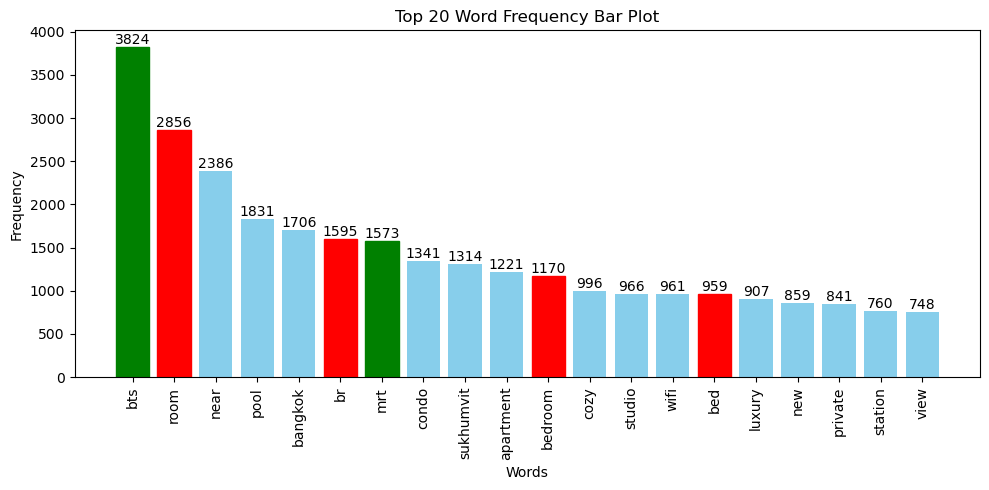

In [19]:
def clean_text2(text):
    stop_words = set(stopwords.words('english'))
    
    text = re.sub(r'\d+', '', text)
    
    words = text.split()
    
    words = [word for word in words if word.lower() not in stop_words]
    
    word_counts = Counter(words)
    return word_counts

# Combine all text from the 'name' column
all_text = ' '.join(df['name'])

# Clean the combined text
word_counts = clean_text2(all_text)

# Get the top 20 most common words
top_20_words = word_counts.most_common(20)

# Prepare data for bar plot
words, counts = zip(*top_20_words)  # Unzip the word counts into two lists

# Create a bar plot for the top 20 words
plt.figure(figsize=(10, 5))
bars = plt.bar(words, counts, color='skyblue')
plt.title('Top 20 Word Frequency Bar Plot')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotate x labels for better readability

# Highlight specific words in red and green
for i, bar in enumerate(bars):
    if words[i].lower() in ['room', 'br', 'bedroom', 'bed', 'beds', 'bedrooms', 'bd', 'bdrm', 'bdrs', 'bdm', 'brs']:
        bar.set_color('red')  # Change bar color to red
    elif words[i].lower() in ['bts', 'mrt']:
        bar.set_color('green')  # Change bar color to green

    # Add annotations on top of each bar
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), str(counts[i]), 
             ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()  # Adjust layout to make room for labels
plt.show()

### Extracting number of bedroom from name column

In [20]:
def detect_bedroom(text):
    # Pattern to match numbers preceding bedroom-related keywords
    pattern = r'(\d+)\s*(?:br|bedroom|bed|beds|bedrooms|bd|bdrm|bdrs|bdm|brs)'
    matches = re.findall(pattern, text, re.IGNORECASE) 
    if matches:
        return int(matches[-1])  
    return 0 

df['bedroom'] = df['name'].apply(detect_bedroom)
df['bedroom'] = df['bedroom'].replace(0, np.nan)

In [21]:
df[df['bedroom'] > 0].shape

(3702, 18)

### Extracting transportation

In [22]:
df[df['name'].str.contains('mrt|bts', case=False, na=False)].shape

(5206, 18)

In [23]:
def extract_station(text):
    if 'bts' in text.lower():
        return 'bts'
    elif 'mrt' in text.lower():
        return 'mrt'
    return None  # Return None if neither is found

# Create a new column 'station' based on the extraction
df['station'] = df['name'].apply(extract_station)

## host_id & host_name

### Check inconsistent

In [24]:
if (df.groupby('host_id')['host_name'].nunique() > 1).any():
    print("There are multiple hosts with the same host_id")
else:
    print("There are no multiple hosts with the same host_id")

There are no multiple hosts with the same host_id


## Neighborhood & Longitude and Latitude Analysis

### Check duplicate

In [25]:
df[df[['longitude', 'latitude']].duplicated()].groupby(['longitude', 'latitude']).size().reset_index(name='count').sort_values(by='count', ascending=False).head(10)

,longitude,latitude,count
40,100.519891,13.710777,20
147,100.563269,13.754188,12
102,100.547070,13.720620,12
171,100.569440,13.760440,11
67,100.531240,13.752840,11
19,100.503922,13.762439,10
118,100.555210,13.739370,10
28,100.513080,13.733280,10
167,100.568770,13.730760,9
143,100.562590,13.733130,9


<b>Download geojson from here:</b>
- https://github.com/pcrete/gsvloader-demo/blob/master/geojson/Bangkok-districts.geojson
- https://github.com/pcrete/gsvloader-demo/blob/master/geojson/Bangkok-subdistricts.geojson

In [26]:
gdf_district = gpd.read_file('Data/Bangkok-districts.geojson')
gdf_district["centroid_district"] = gdf_district["geometry"].centroid

gdf_sub_district = gpd.read_file('Data/Bangkok-subdistricts.geojson')
gdf_sub_district["centroid_sub_district"] = gdf_sub_district["geometry"].centroid

In [27]:
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude))

# Set the same CRS for both GeoDataFrames (using a suitable projection)
gdf_district.set_crs(epsg=4326, inplace=True) 
gdf_sub_district.set_crs(epsg=4326, inplace=True) 
gdf.set_crs(epsg=4326, inplace=True)

gdf = gpd.sjoin(gdf, gdf_district[['dname_e', 'centroid_district', 'geometry']], predicate='within')
gdf.drop(columns=['index_right'], inplace=True)

gdf = gpd.sjoin(gdf, gdf_sub_district[['SNAME', 'centroid_sub_district', 'geometry']], predicate='within')
gdf.drop(columns=['index_right'], inplace=True)

gdf.head()

,id,name,name_ext,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,...,calculated_host_listings_count,availability_365,number_of_reviews_ltm,bedroom,station,geometry,dname_e,centroid_district,SNAME,centroid_sub_district
0,27934,nice room with superb city view,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,...,2,353,0,NaN,None,POINT (100.54134 13.75983),Ratchathewi,POINT (100.53855 13.75726),แขวงถนนพญาไท,POINT (100.53841 13.75732)
1,27979,easy going landlord easy place,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,...,2,358,0,NaN,None,POINT (100.61674 13.66818),Bang Na,POINT (100.61844 13.6677),แขวงบางนา,POINT (100.61844 13.6677)
2,28745,modern style apartment in bangkok,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,...,1,365,0,NaN,None,POINT (100.62402 13.75232),Bang Kapi,POINT (100.6401 13.76933),แขวงหัวหมาก,POINT (100.64383 13.7551)
3,35780,spacious 1 bedroom at the kris condo bldg 3,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,...,1,323,1,1.0,None,POINT (100.57256 13.78823),Din Daeng,POINT (100.56327 13.77507),แขวงดินแดง,POINT (100.56327 13.77507)
4,941865,suite room 3 at metropoint,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,...,3,365,0,NaN,None,POINT (100.63338 13.76872),Bang Kapi,POINT (100.6401 13.76933),แขวงคลองจั่น,POINT (100.63509 13.78845)


In [28]:
if gdf['dname_e'].isna().sum() > 0 or gdf['SNAME'].isna().sum() > 0:
    print("There are some geometry outsite bangkok")
else:
    print("The Geometry is inside Bangkok")

The Geometry is inside Bangkok


In [29]:
gdf[gdf['neighbourhood'].str.lower() != gdf['dname_e'].str.lower()].shape

(0, 24)

In [30]:
gdf.drop(columns=['dname_e'], inplace=True)

In [31]:
def LongLine(x, y):
    line = LineString([x, y])
    geojson_line = {
        'type': 'Feature',
        'properties': {},
        'geometry': mapping(line)
    }
    return calculate_distance(geojson_line, Unit.meters)

gdf['distance_from_district_center'] = gdf.apply(lambda x: LongLine(x['geometry'], x['centroid_district']), axis=1)
gdf['distance_from_sub_district_center'] = gdf.apply(lambda x: LongLine(x['geometry'], x['centroid_sub_district']), axis=1)

## Price

### Anomaly Data

In [32]:
gdf[['name', 'price']].sort_values(by='price').head(5).style.applymap(lambda x: 'color: red' if x == 0 else '', subset=['price'])

,name,price
9887,somerset maison asoke bangkok,0
13650,artist private airroom min 2 skytrainpetfriendly,278
13579,1 lower bunk bed w shared bath,280
13531,mixed dorm bunkbed at amazing khaosan hostel 2,280
13578,1 upper bunk bed w shared bath,280


In [33]:
gdf = gdf[gdf['price'] != 0]
gdf[['name', 'price']].sort_values(by='price').head(5).style.applymap(lambda x: 'color: red' if x == 0 else '', subset=['price'])

,name,price
13650,artist private airroom min 2 skytrainpetfriendly,278
13579,1 lower bunk bed w shared bath,280
13531,mixed dorm bunkbed at amazing khaosan hostel 2,280
13578,1 upper bunk bed w shared bath,280
13592,flourish capsule hostel,295


## Last Review

In [34]:
gdf[['name', 'last_review']].head()

,name,last_review
0,nice room with superb city view,2020-01-06
1,easy going landlord easy place,NaT
2,modern style apartment in bangkok,NaT
3,spacious 1 bedroom at the kris condo bldg 3,2022-04-01
4,suite room 3 at metropoint,NaT


## Review per Month

### Missing Value handling

In [35]:
# Print the count of NaN values in the 'number_of_reviews' column
print(gdf.reviews_per_month.isna().sum())

# Fill NaN values in 'number_of_reviews' based on conditions in 'last_review' and 'reviews_per_month'
condition = (gdf['number_of_reviews'] == 0) & (gdf['reviews_per_month'].isna())

# Fill NaN values in 'number_of_reviews' where the condition is True
gdf.loc[condition, 'reviews_per_month'] = gdf.loc[condition, 'reviews_per_month'].fillna(0)

# Print the count of NaN values in the 'number_of_reviews' column again
print(gdf.reviews_per_month.isna().sum())

5789
0


## Calculated Host Listings Count

### Check Anomaly in the data

In [36]:
check = gdf.groupby(['host_id', 'calculated_host_listings_count']).size().reset_index(name='count').sort_values(by='count', ascending=False)
check[check['count'] != check['calculated_host_listings_count']]

,host_id,calculated_host_listings_count,count


# Hipotesting Test

## Normality Test

In [38]:
Numeric_type = gdf.select_dtypes(include=['int', 'float'])

In [39]:
results = []

# Perform the normality test for each numeric column
for col in Numeric_type.columns:
    stat, p_val = normaltest(Numeric_type[col].dropna())
    if p_val > 0.05:
        result = "normally distributed"
    else:
        result = "not normally distributed"
    
    # Append the result to the list
    results.append({'column': col, 'Test Statistic': stat, 'p_value': p_val, 'result': result})

# Convert the list of results into a DataFrame
normality_results = pd.DataFrame(results)

# Display the DataFrame
normality_results

,column,Test Statistic,p_value,result
0,latitude,4356.959559,0.0,not normally distributed
1,longitude,2077.433462,0.0,not normally distributed
2,price,43046.717756,0.0,not normally distributed
3,minimum_nights,22190.129178,0.0,not normally distributed
4,number_of_reviews,19163.172470,0.0,not normally distributed
5,reviews_per_month,15621.035696,0.0,not normally distributed
6,calculated_host_listings_count,16474.501173,0.0,not normally distributed
7,availability_365,12885.350519,0.0,not normally distributed
8,number_of_reviews_ltm,24895.698981,0.0,not normally distributed
9,bedroom,2082.848851,0.0,not normally distributed


In [40]:
# Create an empty list to store results
results = []

# Loop over each pair of room types
room_types = gdf['room_type'].unique().tolist()

# Perform pairwise t-tests between different room types
for i in range(len(room_types)):
    for j in range(i + 1, len(room_types)):
        room_type_1 = room_types[i]
        room_type_2 = room_types[j]
        
        # Get the price data for each room type, dropping NaNs
        group_1 = gdf[gdf['room_type'] == room_type_1]['price'].dropna()
        group_2 = gdf[gdf['room_type'] == room_type_2]['price'].dropna()
        
        # Perform independent samples t-test (Welch's t-test)
        t_stat, p_val = ttest_ind(group_1, group_2, equal_var=False)
        
        # Create a result string based on p-value
        if p_val > 0.05:
            result = "No significant difference in average price"
        else:
            result = "Significant difference in average price"
        
        # Append the results to the list
        results.append({
            'room_type_1': room_type_1,
            'room_type_2': room_type_2,
            't_statistic': t_stat,
            'p_value': p_val,
            'result': result
        })

# Convert the list of results into a DataFrame
results_df = pd.DataFrame(results)

# Display the DataFrame
results_df

,room_type_1,room_type_2,t_statistic,p_value,result
0,Entire home/apt,Private room,1.023683,3.060022e-01,No significant difference in average price
1,Entire home/apt,Hotel room,0.759066,4.479454e-01,No significant difference in average price
2,Entire home/apt,Shared room,7.664332,1.977270e-14,Significant difference in average price
3,Private room,Hotel room,0.060301,9.519286e-01,No significant difference in average price
4,Private room,Shared room,8.708035,3.948124e-18,Significant difference in average price
5,Hotel room,Shared room,4.387780,1.322175e-05,Significant difference in average price


In [41]:
# Create an empty list to store results
results = []

# Loop over each pair of room types
room_types = gdf['room_type'].unique().tolist()

# Perform pairwise t-tests between different room types
for i in range(len(room_types)):
    for j in range(i + 1, len(room_types)):
        room_type_1 = room_types[i]
        room_type_2 = room_types[j]
        
        # Get the price data for each room type, dropping NaNs
        group_1 = gdf[gdf['room_type'] == room_type_1]['price'].dropna()
        group_2 = gdf[gdf['room_type'] == room_type_2]['price'].dropna()
        
        # Perform independent samples t-test (Welch's t-test)
        t_stat, p_val = mannwhitneyu(group_1, group_2, alternative='two-sided')
        
        # Create a result string based on p-value
        if p_val > 0.05:
            result = "No significant difference in median price"
        else:
            result = "Significant difference in median price"
        
        # Append the results to the list
        results.append({
            'room_type_1': room_type_1,
            'room_type_2': room_type_2,
            't_statistic': t_stat,
            'p_value': p_val,
            'result': result
        })

# Convert the list of results into a DataFrame
results_df = pd.DataFrame(results)

# Display the DataFrame
results_df

,room_type_1,room_type_2,t_statistic,p_value,result
0,Entire home/apt,Private room,30317205.5,2.564177e-75,Significant difference in median price
1,Entire home/apt,Hotel room,2795910.0,1.769848e-01,No significant difference in median price
2,Entire home/apt,Shared room,4161821.0,5.076694e-201,Significant difference in median price
3,Private room,Hotel room,1529918.0,3.117582e-14,Significant difference in median price
4,Private room,Shared room,2562637.0,1.275102e-154,Significant difference in median price
5,Hotel room,Shared room,292717.5,6.966201e-102,Significant difference in median price


In [42]:
# Create an empty list to store results
results = []

# Iterate over the numeric columns, excluding 'price'
for col in gdf.select_dtypes(include=['int', 'float']).columns:
    
    # Ensure that we don't calculate correlation with 'price' against itself
    if col != 'price':
        # Remove missing values for the specific column and price
        spear_test = gdf[['price', col]].dropna()
        
        # Calculate Spearman correlation
        corr, p_val = spearmanr(spear_test['price'], spear_test[col])
        
        # Determine result based on p-value
        if p_val > 0.05:
            result = "No correlation"
        else:
            result = "Has correlation"

        if abs(corr) > 0.5:
            correlation = "Strong correlation"
        elif abs(corr) > 0.3:
            correlation = "Moderate correlation"
        elif abs(corr) > 0.1:
            correlation = "Weak correlation"
        else:
            correlation = "No correlation"
        
        # Append the results to the list
        results.append({
            'column': col,
            'spearman_correlation': corr,
            'p_value': p_val,
            'result': result,
            'correlation': correlation
        })

# Convert the list of results into a DataFrame
results_df = pd.DataFrame(results)

# Display the DataFrame
results_df

,column,spearman_correlation,p_value,result,correlation
0,latitude,-0.047731,1.825072e-09,Has correlation,No correlation
1,longitude,-0.069075,3.122815e-18,Has correlation,No correlation
2,minimum_nights,-0.102312,3.709713e-38,Has correlation,Weak correlation
3,number_of_reviews,-0.020784,8.872350e-03,Has correlation,No correlation
4,reviews_per_month,0.017104,3.128004e-02,Has correlation,No correlation
5,calculated_host_listings_count,0.084398,1.848012e-26,Has correlation,No correlation
6,availability_365,-0.000729,9.268605e-01,No correlation,No correlation
7,number_of_reviews_ltm,0.043644,3.854827e-08,Has correlation,No correlation
8,bedroom,0.387214,1.037691e-132,Has correlation,Moderate correlation
9,distance_from_district_center,-0.003017,7.040382e-01,No correlation,No correlation


In [43]:
# Group gdf by neighborhood and filter groups with at least 2 listings
neighborhoods = gdf.groupby('station')['price'].filter(lambda x: len(x) > 1).dropna()
groups = [prices for _, prices in neighborhoods.groupby(gdf['station'])]

# Perform ANOVA to test for price differences across neighborhoods
f_stat, p_val = f_oneway(*groups)

print("F-statistic:", f_stat)
print("P-value:", p_val)
if p_val < 0.05:
    print("result: There is a significant difference in price across station.")
else:
    print("result: There is no significant difference in price across station.")

F-statistic: 2.8266528793936403
P-value: 0.0927714080567542
result: There is no significant difference in price across station.


# Data Visualization

## Univariate Analysis

### Name

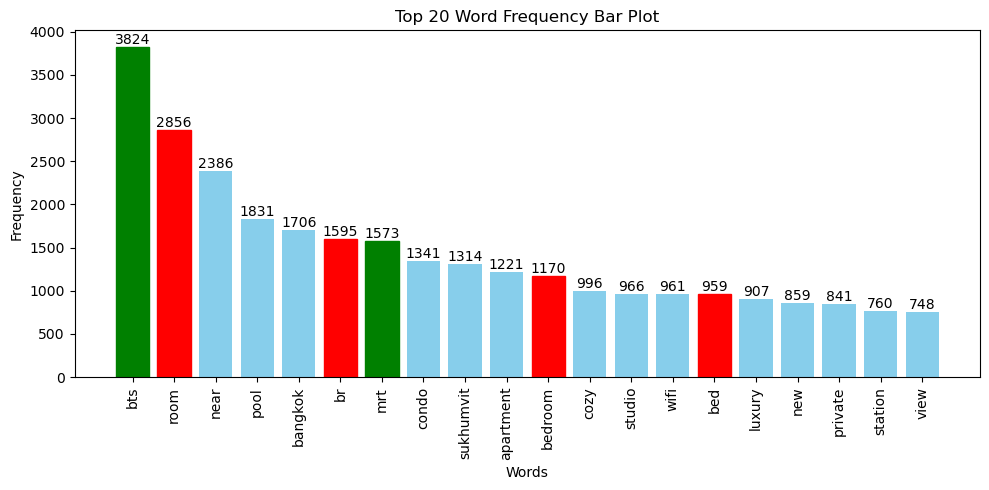

In [44]:
# Create a bar plot for the top 20 words
plt.figure(figsize=(10, 5))
bars = plt.bar(words, counts, color='skyblue')
plt.title('Top 20 Word Frequency Bar Plot')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotate x labels for better readability

# Highlight specific words in red and green
for i, bar in enumerate(bars):
    if words[i].lower() in ['room', 'br', 'bedroom', 'bed', 'beds', 'bedrooms', 'bd', 'bdrm', 'bdrs', 'bdm', 'brs']:
        bar.set_color('red')  # Change bar color to red
    elif words[i].lower() in ['bts', 'mrt']:
        bar.set_color('green')  # Change bar color to green

    # Add annotations on top of each bar
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), str(counts[i]), 
             ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()  # Adjust layout to make room for labels
plt.show()

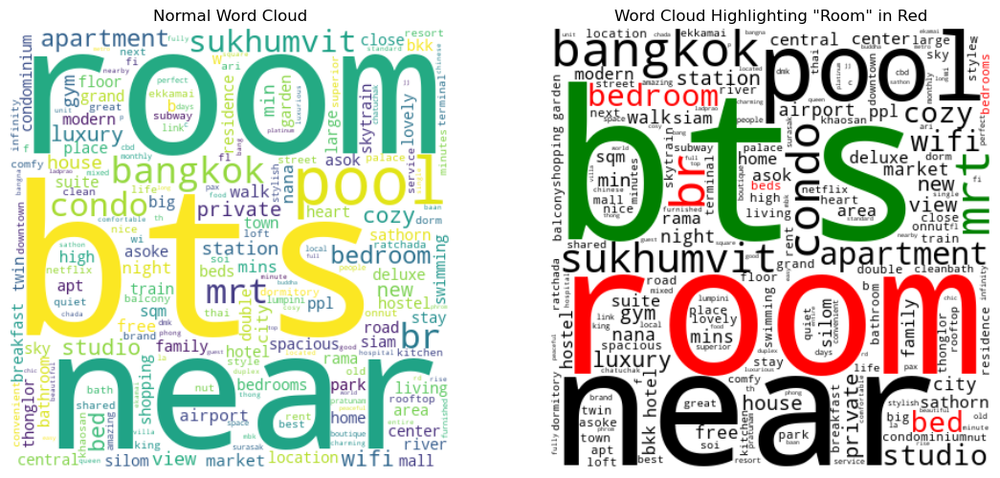

In [46]:
# Create a custom coloring function
def color_func(word, font_size, position, orientation, random_state=None, **kwargs):
    if word.lower() in ['room', 'br', 'bedroom', 'bed', 'beds', 'bedrooms', 'bd', 'bdrm', 'bdrs', 'bdm', 'brs']:  # Check if the word is 'room'
        return 'red' 
    elif word.lower() in ['bts', 'mrt']:
        return 'green'
    else:
        return 'black'

# Create the normal word cloud
normal_wordcloud = WordCloud(width=400, height=400, background_color='white').generate_from_frequencies(word_counts)

# Create the word cloud with color_func
highlighted_wordcloud = WordCloud(width=400, height=400, background_color='white', 
                                   color_func=color_func).generate_from_frequencies(word_counts)

# Plot the word clouds side by side with borders
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Normal word cloud
ax[0].imshow(normal_wordcloud, interpolation='bilinear')
ax[0].axis('off')  # Hide the axis
ax[0].set_title('Normal Word Cloud')

# Word cloud with custom color function
ax[1].imshow(highlighted_wordcloud, interpolation='bilinear')
ax[1].axis('off')  # Hide the axis
ax[1].set_title('Word Cloud Highlighting "Room" in Red')

plt.tight_layout(pad=5)  # Adjust layout and add space between plots
plt.show()

### host_id & host_name

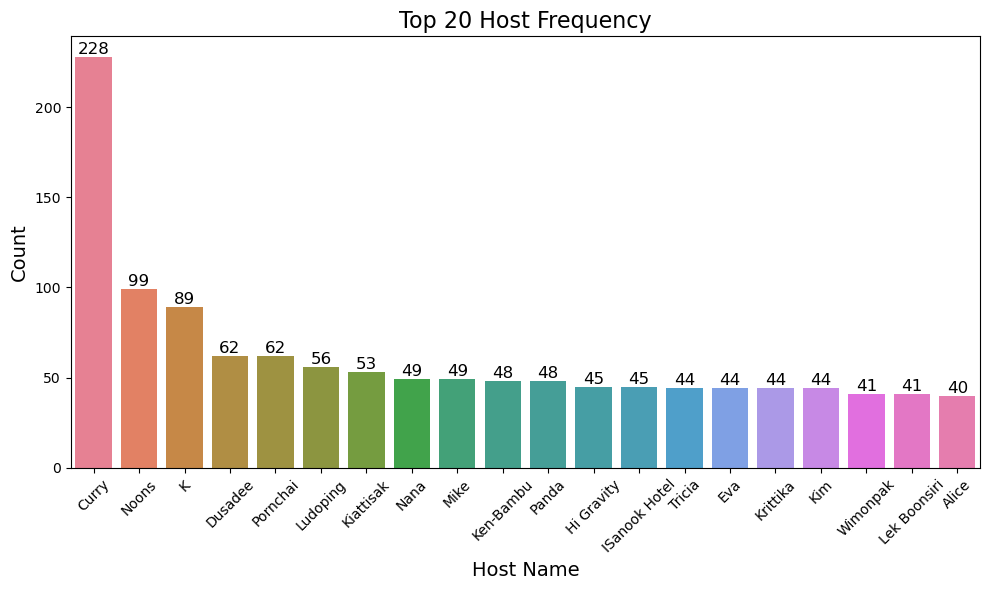

In [47]:
host_count = gdf['host_id'].value_counts().reset_index()
host_count.columns = ['host_id', 'count']

# Merge to get host_name based on host_id
host_names = gdf[['host_id', 'host_name']].drop_duplicates()
host_id_names = host_count.merge(host_names, on='host_id')

# Sort the DataFrame by count in descending order and select the top 20
host_id_names = host_id_names.sort_values(by='count', ascending=False).head(20)

# Create a color palette
palette = sns.color_palette("husl", len(host_id_names))  # Use a color palette with as many colors as unique host_ids

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = sns.barplot(x='host_name', y='count', data=host_id_names, palette=palette)

# Adding title and labels
plt.title('Top 20 Host Frequency', fontsize=16)
plt.xlabel('Host Name', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)  # Rotate x labels for better readability

# Add annotations on top of each bar
for bar in bars.patches:
    # Get the height of each bar
    height = bar.get_height()
    # Add annotation
    plt.text(bar.get_x() + bar.get_width() / 2, height, int(height), 
             ha='center', va='bottom', fontsize=12, color='black')

# Show the plot
plt.tight_layout()
plt.show()

### neighbourhood

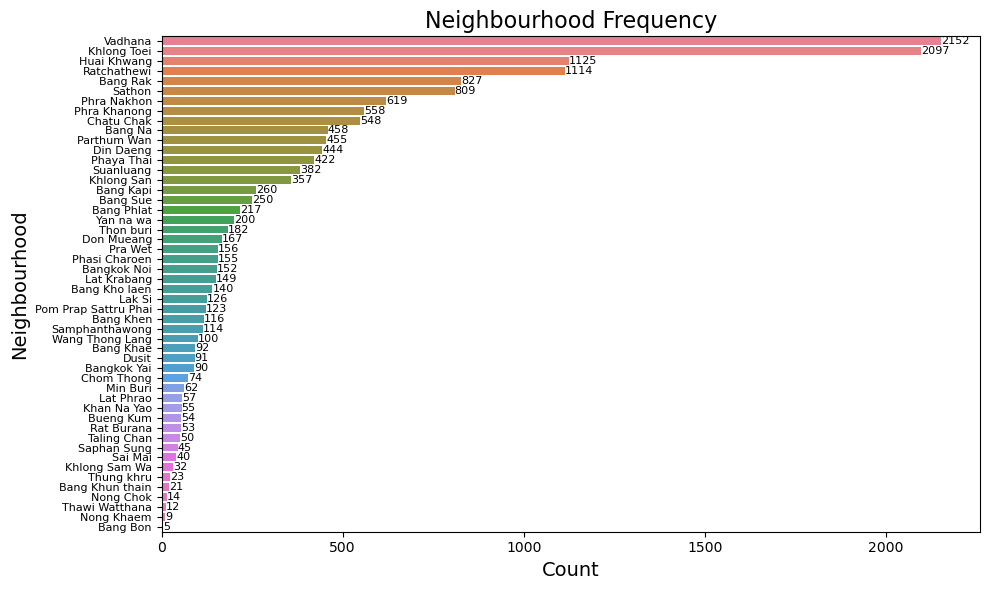

In [48]:
# Count occurrences of each neighbourhood
neighbourhood_count = gdf['neighbourhood'].value_counts().reset_index()
neighbourhood_count.columns = ['neighbourhood', 'count']

# Ensure sorting by count in descending order
neighbourhood_count = neighbourhood_count.sort_values(by='count', ascending=False).reset_index(drop=True)

# Create a color palette
palette = sns.color_palette("husl", len(neighbourhood_count))  # Use a color palette with as many colors as unique neighbourhoods

# Set the order explicitly for y-axis categories
plt.figure(figsize=(10, 6))
bars = sns.barplot(
    x='count', 
    y='neighbourhood', 
    data=neighbourhood_count, 
    palette=palette, 
    order=neighbourhood_count['neighbourhood']  # Set order by sorted neighbourhoods
)

# Adding title and labels
plt.title('Neighbourhood Frequency', fontsize=16)
plt.xlabel('Count', fontsize=14)
plt.ylabel('Neighbourhood', fontsize=14)
plt.yticks(fontsize=8)

# Add annotations on top of each bar
for bar in bars.patches:
    # Get the width of each bar
    width = bar.get_width()
    # Add annotation
    plt.text(width, bar.get_y() + bar.get_height() / 2, int(width), 
             ha='left', va='center', fontsize=8, color='black')

# Show the plot
plt.tight_layout()
plt.show()


### latitude and longitude

In [ ]:
def resize_image_from_url(image_url, width, height):
    response = requests.get(image_url)
    img = Image.open(BytesIO(response.content))
    img_resized = img.resize((width, height))
    img_byte_arr = BytesIO()
    img_resized.save(img_byte_arr, format='PNG')
    img_base64 = base64.b64encode(img_byte_arr.getvalue()).decode('utf-8')
    return img_base64

# URL of the image
url = "https://llv-res.twospaces.id/portfolios-purwadhika.png"
resized_image_base64 = resize_image_from_url(url, 178, 27)
image_html = f"data:image/png;base64,{resized_image_base64}"

# Create the folium map
fig = Figure(width=1200, height=600)
m = folium.Map(location=[gdf['latitude'].mean(), gdf['longitude'].mean()], zoom_start=10, tiles='CartoDB positron')

# Marker Cluster and Mouse Position
fg = folium.FeatureGroup(name="Listings", show=True).add_to(m)
marker_cluster = MarkerCluster().add_to(fg)

# Add markers for each point in the DataFrame
for _, row in gdf.iterrows():
    html = row[['name', 'room_type', 'price', 'minimum_nights', 'number_of_reviews']].to_frame().to_html(
        classes="table table-striped table-hover table-condensed table-responsive",
        index=True, 
        header=True
    )
    category = row['neighbourhood']
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(html, max_width=300)
    ).add_to(marker_cluster)

fg1 = folium.FeatureGroup(name="Heatmap", show=True).add_to(m)
HeatMap([(row['latitude'], row['longitude']) for _, row in gdf.iterrows()]).add_to(fg1)

# FeatureGroup for Districts
fg2 = folium.FeatureGroup(name="Districts", show=True).add_to(m)
for _, row in gdf_district.iterrows():
    geo_j = gpd.GeoSeries(row["geometry"]).to_json()
    geo_j = folium.GeoJson(
        data=geo_j,
        style_function=lambda x: {
            "fillColor": "orange",
            "weight": 1,
            "fillOpacity": 0.1,
            "stroke": True
        }
    )
    folium.Popup(row["dname_e"]).add_to(geo_j)
    geo_j.add_to(fg2)

# FeatureGroup for Sub-Districts
fg3 = folium.FeatureGroup(name="Sub-Districts", show=False).add_to(m)
for _, row in gdf_sub_district.iterrows():
    geo_j = gpd.GeoSeries(row["geometry"]).to_json()
    geo_j = folium.GeoJson(
        data=geo_j,
        style_function=lambda x: {
            "fillColor": "orange",
            "weight": 1,
            "fillOpacity": 0.1,
            "stroke": True
        }
    )
    folium.Popup(row["SNAME"]).add_to(geo_j)
    geo_j.add_to(fg3)

# Add LayerControl and Floating Image
folium.LayerControl().add_to(m)
FloatImage(image_html, bottom=91, left=5).add_to(m)

# Save and show the map
fig.add_child(m)
m.save("map.html")
m

### room_type

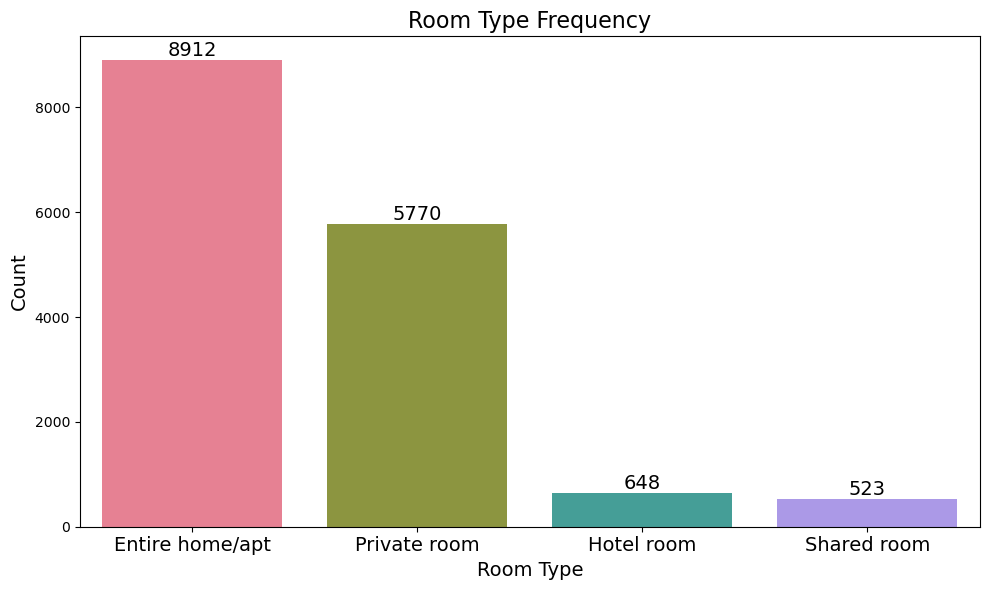

In [50]:
# Count occurrences of each room type
room_count = gdf['room_type'].value_counts().reset_index()
room_count.columns = ['room_type', 'count']

# Sort the DataFrame by count in descending order
room_count = room_count.sort_values(by='count', ascending=False)

# Create a color palette
palette = sns.color_palette("husl", len(room_count))  # Use a color palette with as many colors as unique room types

# Set the order for x-axis categories
plt.figure(figsize=(10, 6))
bars = sns.barplot(
    x='room_type', 
    y='count', 
    data=room_count, 
    palette=palette, 
    order=room_count['room_type']  # Set order by sorted room types
)

# Adding title and labels
plt.title('Room Type Frequency', fontsize=16)
plt.xlabel('Room Type', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(fontsize=14, rotation=0)  # Adjust font size and rotate x-ticks for readability

# Add annotations on top of each bar
for bar in bars.patches:
    # Get the height of each bar
    height = bar.get_height()
    # Add annotation
    plt.text(bar.get_x() + bar.get_width() / 2, height, int(height), 
             ha='center', va='bottom', fontsize=14, color='black')

# Show the plot
plt.tight_layout()
plt.show()


### price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, availability_365, number_of_reviews_ltm, bedroom, distance_from_district_center, distance_from_sub_district_center

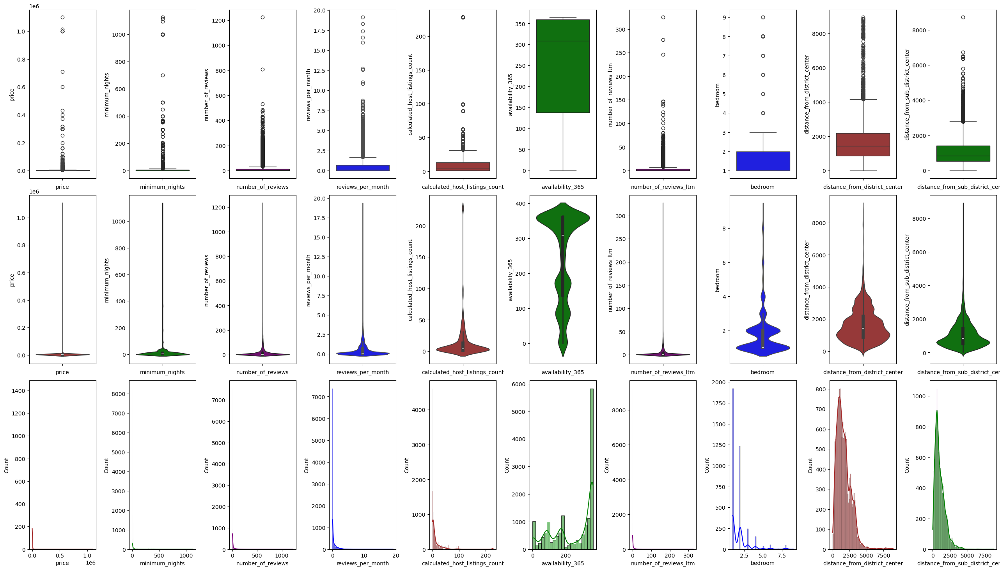

In [51]:
numeric_col = ['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365', 'number_of_reviews_ltm', 'bedroom', 'distance_from_district_center', 'distance_from_sub_district_center']

data_df = gdf[numeric_col]

fig, ax = plt.subplots(3, data_df.shape[1], figsize=(32, 18))
plt.subplots_adjust(wspace=0.5, hspace=0.1)
colors = ['brown', 'green', 'purple', 'blue']

# Row 1: Boxplots
for i, col in enumerate(data_df.columns):
    sns.boxplot(data=data_df[col], ax=ax[0, i], color=colors[i % 4])
    ax[0, i].set_xlabel(col)
    ax[0, i].set_xticklabels([])

# Row 2: Violin plots
for i, col in enumerate(data_df.columns):
    sns.violinplot(data=data_df[col], ax=ax[1, i], color=colors[i % 4])
    ax[1, i].set_xlabel(col)
    ax[1, i].set_xticklabels([])

# Row 3: Histograms
for i, col in enumerate(data_df.columns):
    sns.histplot(data=data_df[col], ax=ax[2, i], kde=True, color=colors[i % 4])
    ax[2, i].set_xlabel(col)

plt.show()

In [52]:
def total_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    print(f"'{column}' has {outliers.shape[0]} or {(len(outliers)/len(df)*100):.2f}% outliers")

for col in numeric_col:
    total_outliers(gdf, col)
    print("-"*70, end='\n')

'price' has 1403 or 8.85% outliers
----------------------------------------------------------------------
'minimum_nights' has 3168 or 19.98% outliers
----------------------------------------------------------------------
'number_of_reviews' has 2240 or 14.13% outliers
----------------------------------------------------------------------
'reviews_per_month' has 1471 or 9.28% outliers
----------------------------------------------------------------------
'calculated_host_listings_count' has 1832 or 11.56% outliers
----------------------------------------------------------------------
'availability_365' has 0 or 0.00% outliers
----------------------------------------------------------------------
'number_of_reviews_ltm' has 2219 or 14.00% outliers
----------------------------------------------------------------------
'bedroom' has 299 or 1.89% outliers
----------------------------------------------------------------------
'distance_from_district_center' has 291 or 1.84% outliers
-------

### last_review

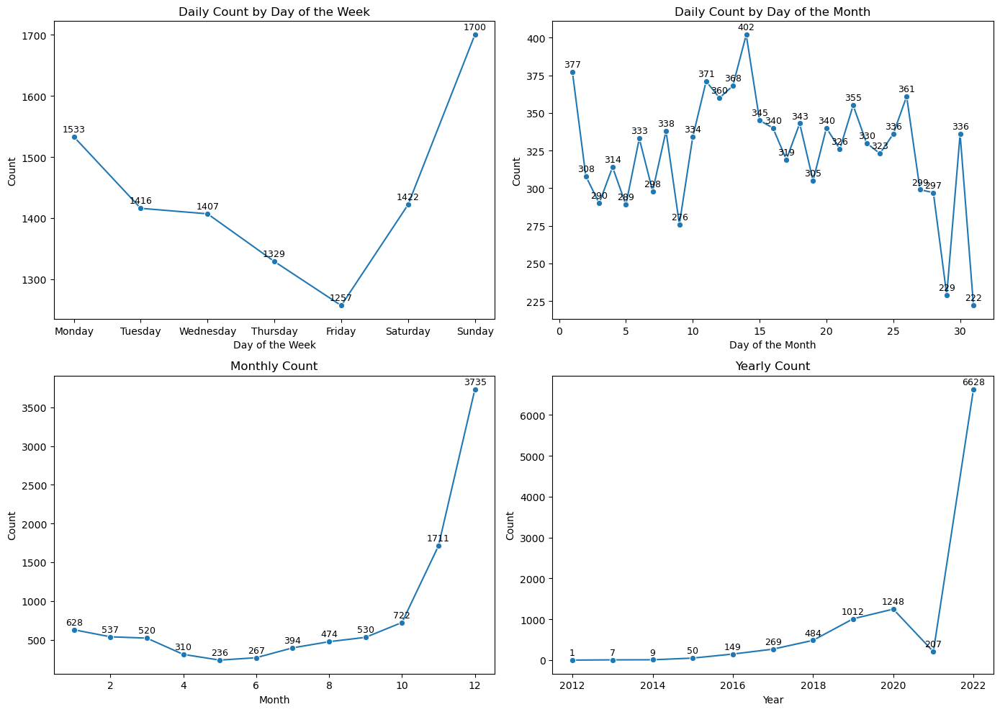

In [70]:
# Assuming 'last_review' column exists in `df`
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')
df['day_of_week'] = df['last_review'].dt.day_name()
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df['day_of_week'] = pd.Categorical(df['day_of_week'], categories=day_order, ordered=True)

df['day_of_month'] = df['last_review'].dt.day
df['month'] = df['last_review'].dt.month
df['year'] = df['last_review'].dt.year

# Group by day of the week
daily_data = df.groupby('day_of_week').agg({'id': 'count'}).reset_index()
daily_data.columns = ['day_of_week', 'count']

# Group by day of the month
day_of_month_data = df.groupby('day_of_month').agg({'id': 'count'}).reset_index()
day_of_month_data.columns = ['day_of_month', 'count']

# Group by month
monthly_data = df.groupby('month').agg({'id': 'count'}).reset_index()
monthly_data.columns = ['month', 'count']

# Group by year
yearly_data = df.groupby('year').agg({'id': 'count'}).reset_index()
yearly_data.columns = ['year', 'count']

fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# Daily (Day of the Week)
sns.lineplot(x='day_of_week', y='count', data=daily_data, ax=axs[0, 0], marker='o')
axs[0, 0].set_title('Daily Count by Day of the Week')
axs[0, 0].set_xlabel('Day of the Week')
axs[0, 0].set_ylabel('Count')
for x, y in zip(daily_data['day_of_week'], daily_data['count']):
    axs[0, 0].annotate(f"{y}", xy=(x, y), xytext=(0, 5), textcoords='offset points', ha='center', fontsize=9)

# Day of the Month
sns.lineplot(x='day_of_month', y='count', data=day_of_month_data, ax=axs[0, 1], marker='o')
axs[0, 1].set_title('Daily Count by Day of the Month')
axs[0, 1].set_xlabel('Day of the Month')
axs[0, 1].set_ylabel('Count')
for x, y in zip(day_of_month_data['day_of_month'], day_of_month_data['count']):
    axs[0, 1].annotate(f"{y}", xy=(x, y), xytext=(0, 5), textcoords='offset points', ha='center', fontsize=9)

# Monthly
sns.lineplot(x='month', y='count', data=monthly_data, ax=axs[1, 0], marker='o')
axs[1, 0].set_title('Monthly Count')
axs[1, 0].set_xlabel('Month')
axs[1, 0].set_ylabel('Count')
for x, y in zip(monthly_data['month'], monthly_data['count']):
    axs[1, 0].annotate(f"{y}", xy=(x, y), xytext=(0, 5), textcoords='offset points', ha='center', fontsize=9)

# Yearly
sns.lineplot(x='year', y='count', data=yearly_data, ax=axs[1, 1], marker='o')
axs[1, 1].set_title('Yearly Count')
axs[1, 1].set_xlabel('Year')
axs[1, 1].set_ylabel('Count')
for x, y in zip(yearly_data['year'], yearly_data['count']):
    axs[1, 1].annotate(f"{y}", xy=(x, y), xytext=(0, 5), textcoords='offset points', ha='center', fontsize=9)

plt.tight_layout()
plt.show()

# Extracting file

In [62]:
gdf1 = gdf.copy()
gdf1['longitude_centroid_district'] = gdf.centroid_district.x
gdf1['latitude_centroid_district'] = gdf.centroid_district.y

gdf1['longitude_centroid_sub_district'] = gdf.centroid_sub_district.x
gdf1['latitude_centroid_sub_district'] = gdf.centroid_sub_district.y

gdf1 = gdf1[['id', 'name', 'name_ext', 'host_id', 'host_name', 'neighbourhood', 'SNAME',
        'room_type', 'minimum_nights', 'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365', 'number_of_reviews_ltm', 'bedroom', 'station', 
       'distance_from_district_center', 'distance_from_sub_district_center',
       'price', 'longitude_centroid_district', 'latitude_centroid_district',
       'longitude_centroid_sub_district', 'latitude_centroid_sub_district',
       'latitude', 'longitude', 'geometry']]
gdf1.to_file("Airbnb Listings Bangkok.geojson")

Moving to Tableau

In [76]:
gdf.id.nunique()

15853